In [1]:
%pip install ibm-watsonx-ai==1.1.20 image==1.5.33 requests==2.32.0

  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 49.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
Reason for being yanked: Yanked due to conflicts with CVE-2024-35195 mitigation
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 61.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.7/11.7 MB 147.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.3/8.3 MB 164.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.6/6.6 MB 143.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.0/18.0 MB 168.9 MB/s eta 0:00:00
  Created wheel for image: filename=image-1.5.33-py2.py3-none-any.whl size=19525 sha256=d13952815a3b038efa1de1e1803f44b3700331497755a7d9e80c19285f975aa5
  Stored in directory: /home/jupyterlab/.cache/pip/wheels/58/30/d8/3212cd83eeeeee0a1f0c7b9b7bd0674a2b9f09342870473a2a
  Created whe

In [2]:
from ibm_watsonx_ai import Credentials, APIClient
import os

credentials = Credentials(
    url="https://us-south.ml.cloud.ibm.com",
    )

project_id="skills-network"
client = APIClient(credentials)
# GET TextModels ENUM
client.foundation_models.TextModels

# PRINT dict of Enums
client.foundation_models.TextModels.show()

{'FLAN_T5_XL': 'google/flan-t5-xl', 'GRANITE_13B_INSTRUCT_V2': 'ibm/granite-13b-instruct-v2', 'GRANITE_3_2_8B_INSTRUCT': 'ibm/granite-3-2-8b-instruct', 'GRANITE_3_2B_INSTRUCT': 'ibm/granite-3-2b-instruct', 'GRANITE_3_3_8B_INSTRUCT': 'ibm/granite-3-3-8b-instruct', 'GRANITE_3_8B_INSTRUCT': 'ibm/granite-3-8b-instruct', 'GRANITE_8B_CODE_INSTRUCT': 'ibm/granite-8b-code-instruct', 'GRANITE_GUARDIAN_3_2B': 'ibm/granite-guardian-3-2b', 'GRANITE_GUARDIAN_3_8B': 'ibm/granite-guardian-3-8b', 'GRANITE_VISION_3_2_2B': 'ibm/granite-vision-3-2-2b', 'LLAMA_2_13B_CHAT': 'meta-llama/llama-2-13b-chat', 'LLAMA_3_2_11B_VISION_INSTRUCT': 'meta-llama/llama-3-2-11b-vision-instruct', 'LLAMA_3_2_1B_INSTRUCT': 'meta-llama/llama-3-2-1b-instruct', 'LLAMA_3_2_3B_INSTRUCT': 'meta-llama/llama-3-2-3b-instruct', 'LLAMA_3_2_90B_VISION_INSTRUCT': 'meta-llama/llama-3-2-90b-vision-instruct', 'LLAMA_3_3_70B_INSTRUCT': 'meta-llama/llama-3-3-70b-instruct', 'LLAMA_3_405B_INSTRUCT': 'meta-llama/llama-3-405b-instruct', 'LLAMA_4_

In [1]:
url_image_1 = 'https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/5uo16pKhdB1f2Vz7H8Utkg/image-1.png'
url_image_2 = 'https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/fsuegY1q_OxKIxNhf6zeYg/image-2.png'
url_image_3 = 'https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/KCh_pM9BVWq_ZdzIBIA9Fw/image-3.png'
url_image_4 = 'https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/VaaYLw52RaykwrE3jpFv7g/image-4.png'

image_urls = [url_image_1, url_image_2, url_image_3, url_image_4] 

Image 1:


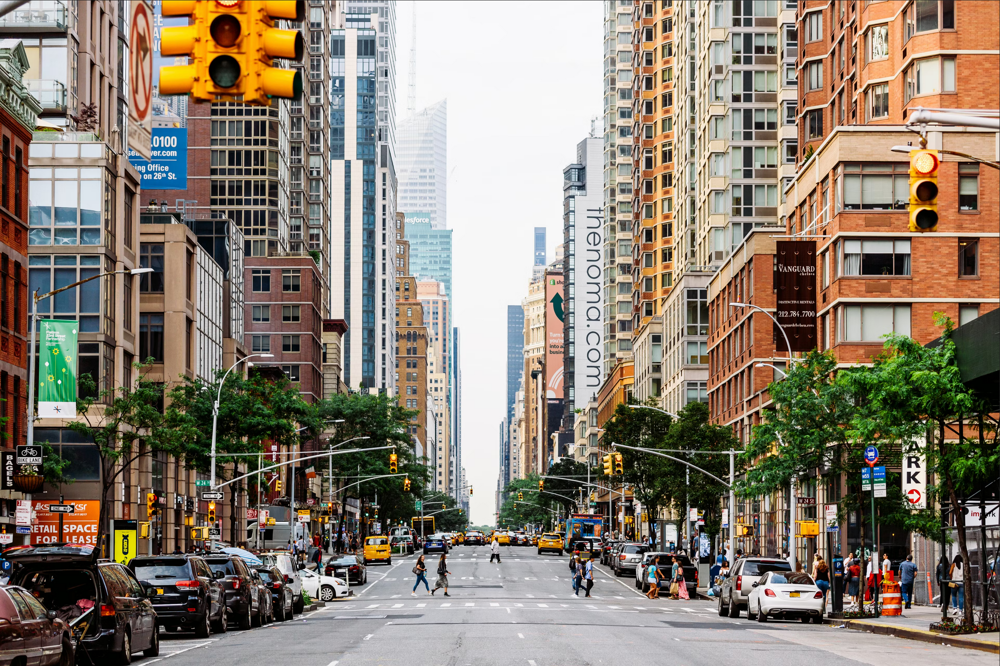

Image 2:


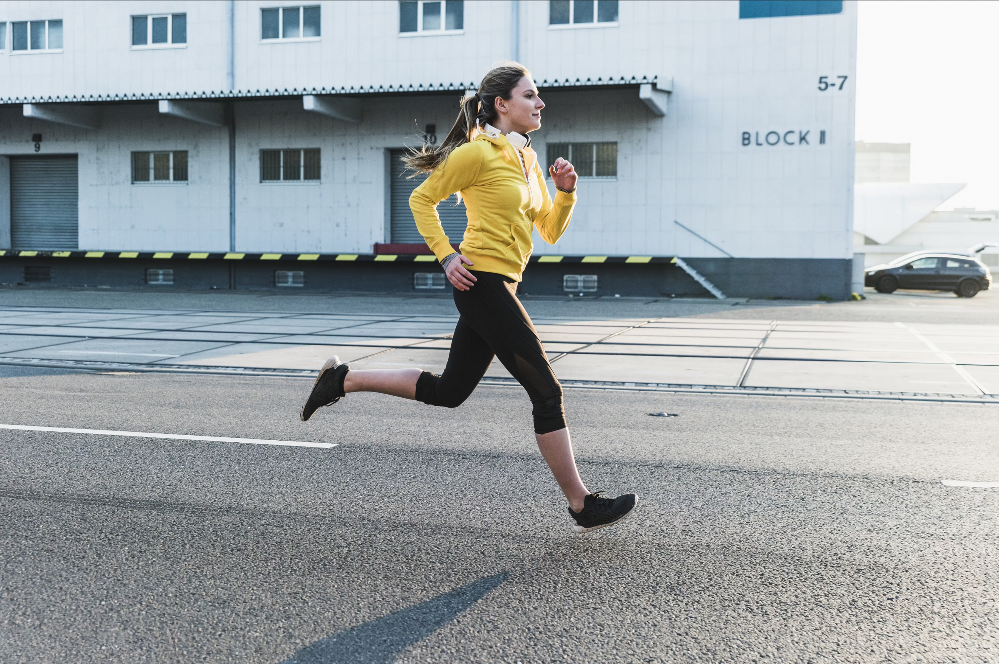

Image 3:


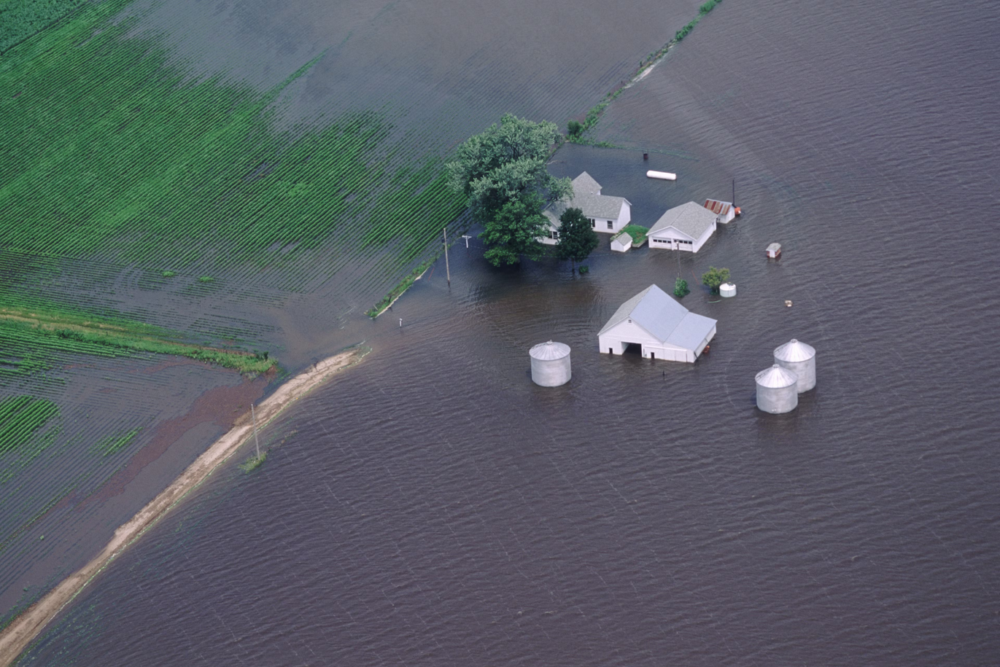

Image 4:


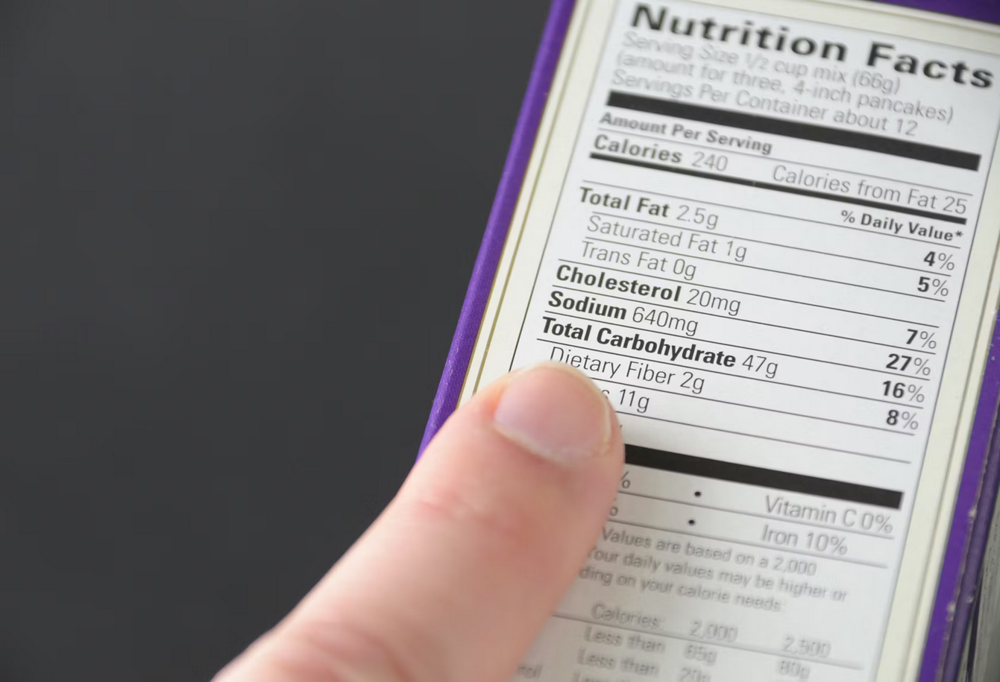

In [4]:
import requests
from PIL import Image
from io import BytesIO
from IPython.display import display

for idx, url in enumerate(image_urls, 1):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    print(f"Image {idx}:")
    display(img)

In [5]:
model_id = 'ibm/granite-vision-3-2-2b'

In [6]:
from ibm_watsonx_ai.foundation_models.schema import TextChatParameters

TextChatParameters.show()

params = TextChatParameters(
    temperature=0.2,
    top_p=0.5,

)

+-------------------+-----------------------------------------------------------------------------------+-------------------------+
| PARAMETER         | TYPE                                                                              | EXAMPLE VALUE           |
+===================+===================================================================================+=========================+
| frequency_penalty | float | None                                                                      | 0.5                     |
+-------------------+-----------------------------------------------------------------------------------+-------------------------+
| logprobs          | bool | None                                                                       | True                    |
+-------------------+-----------------------------------------------------------------------------------+-------------------------+
| top_logprobs      | int | None                                            

In [7]:
import os
from ibm_watsonx_ai.foundation_models import ModelInference

model = ModelInference(
    model_id=model_id,
    credentials=credentials,
    project_id=project_id,
    params=params
)

/opt/conda/lib/python3.12/site-packages/ibm_watsonx_ai/foundation_models/utils/utils.py:415: LifecycleWarning: Model 'ibm/granite-vision-3-2-2b' is in deprecated state from 2025-08-13 until 2025-11-12. IDs of alternative models: None. Further details: https://dataplatform.cloud.ibm.com/docs/content/wsj/analyze-data/fm-model-lifecycle.html?context=wx&audience=wdp
  warnings.warn(


In [8]:
import base64
import requests

def encode_images_to_base64(image_urls):
    """
    Downloads and encodes a list of image URLs to base64 strings.

    Parameters:
    - image_urls (list): A list of image URLs.

    Returns:
    - list: A list of base64-encoded image strings.
    """
    encoded_images = []
    for url in image_urls:
        response = requests.get(url)
        if response.status_code == 200:
            encoded_image = base64.b64encode(response.content).decode("utf-8")
            encoded_images.append(encoded_image)
            print(type(encoded_image))
        else:
            print(f"Warning: Failed to fetch image from {url} (Status code: {response.status_code})")
            encoded_images.append(None)
    return encoded_images

In [9]:
encoded_images = encode_images_to_base64(image_urls)

<class 'str'>
<class 'str'>
<class 'str'>
<class 'str'>


In [10]:
def generate_model_response(encoded_image, user_query, assistant_prompt="You are a helpful assistant. Answer the following user query in 1 or 2 sentences: "):
    """
    Sends an image and a query to the model and retrieves the description or answer.

    Parameters:
    - encoded_image (str): Base64-encoded image string.
    - user_query (str): The user's question about the image.
    - assistant_prompt (str): Optional prompt to guide the model's response.

    Returns:
    - str: The model's response for the given image and query.
    """
    
    # Create the messages object
    messages = [
        {
            "role": "user",
            "content": [
                {
                    "type": "text",
                    "text": assistant_prompt + user_query
                },
                {
                    "type": "image_url",
                    "image_url": {
                        "url": "data:image/jpeg;base64," + encoded_image,
                    }
                }
            ]
        }
    ]
    
    # Send the request to the model
    response = model.chat(messages=messages)
    
    # Return the model's response
    return response['choices'][0]['message']['content']

In [11]:
user_query = "Describe the photo"

for i in range(len(encoded_images)):
    image = encoded_images[i]

    response = generate_model_response(image, user_query)

    # Print the response with a formatted description
    print(f"Description for image {i + 1}: {response}/n/n")

Description for image 1: The photo captures a bustling urban street scene, likely in a major city given the high-rise buildings and the density of the architecture. The street is lined with a variety of commercial establishments, including a prominent office building with a sign that reads "The Nomad.com." The presence of pedestrians and vehicles suggests a typical day in a busy metropolitan area. The overcast sky and the absence of leaves on the trees indicate that the photo was taken in a season when the weather is cooler, possibly autumn or winter. The image does not provide any direct information about the location, but the style of the buildings and the overall ambiance suggest it could be in a major city in North America./n/n
Description for image 2: The photo captures a moment of athleticism and urban life. The subject, a woman, is engaged in a running activity, which is a common form of exercise and a way to stay active in a city environment. Her attire is appropriate for physi

In [14]:
image = encoded_images[3]

user_query = "Is this a nutrit?"

print("User Query: ", user_query)
print("Model Response: ", generate_model_response(image, user_query))

User Query:  How many cars are in this image?
Model Response:  There are no cars visible in the image. The focus is on the flooded rural landscape, which includes agricultural fields, a house, and storage tanks. The absence of vehicles suggests that the area may be inaccessible or that the flooding has prevented transportation.
